In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
from IPython.display import HTML,Video
from moviepy.editor import VideoFileClip
from PerspectiveTransformation import *
from LaneLines import *

In [2]:
images = []
images.append(mpimg.imread('test_images/challenge_video_frame_1.jpg'))
images.append(mpimg.imread('test_images/challenge_video_frame_100.jpg'))
images.append(mpimg.imread('test_images/challenge_video_frame_110.jpg'))
images.append(mpimg.imread('test_images/challenge_video_frame_120.jpg'))
images.append(mpimg.imread('test_images/challenge_video_frame_130.jpg'))
images.append(mpimg.imread('test_images/challenge_video_frame_140.jpg'))

In [3]:
images1 = []
images1.append(mpimg.imread('test_images/project_video_frame_1032.jpg'))
images1.append(mpimg.imread('test_images/project_video_frame_1048.jpg'))
images1.append(mpimg.imread('test_images/project_video_frame_235.jpg'))
images1.append(mpimg.imread('test_images/project_video_frame_810.jpg'))
images1.append(mpimg.imread('test_images/project_video_frame_551.jpg'))

In [4]:
images2 = []
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_1.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_10.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_100.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_200.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_300.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_400.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_500.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_600.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_700.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_800.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_900.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_1000.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_1100.jpg'))

In [5]:
def plot(img):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    f = plt.figure(figsize=(24, 9))
    ax1 = f.add_subplot(1, 3, 1)
    ax1.imshow(hls[:,:,0], cmap='gray', vmin=0, vmax=255)
    ax2 = f.add_subplot(1, 3, 2)
    ax2.imshow(hls[:,:,1], cmap='gray', vmin=0, vmax=255)
    ax3 = f.add_subplot(1, 3, 3)
    ax3.imshow(hls[:,:,2], cmap='gray', vmin=0, vmax=255)
    plt.figure()
    plt.imshow(img)

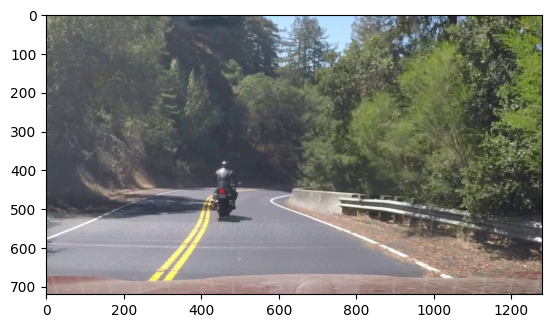

In [47]:
img = images2[2]
birdeye = PerspectiveTransformation()
plt.imshow(img)

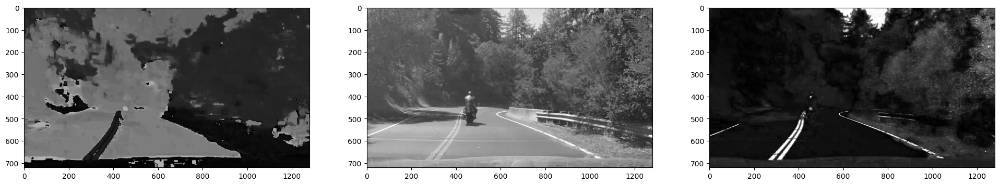

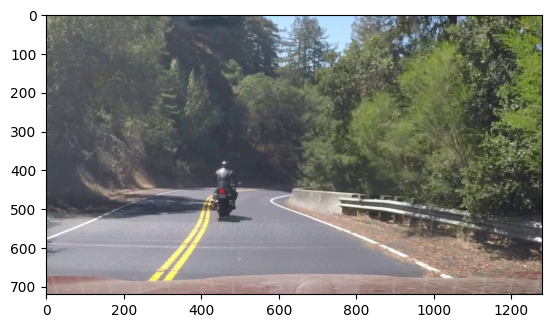

In [48]:
plot(img)

In [49]:
def threshold_rel(img, lo, hi):
    vmin = np.min(img)
    vmax = np.max(img)
    
    vlo = vmin + (vmax - vmin) * lo
    vhi = vmin + (vmax - vmin) * hi
    return np.uint8((img >= vlo) & (img <= vhi)) * 255

def threshold_abs(img, lo, hi):
    return np.uint8((img >= lo) & (img <= hi)) * 255

In [66]:
def test(img):
    tmp = birdeye.forward(img)
    tmp = np.copy(img)
    hls = cv2.cvtColor(tmp, cv2.COLOR_RGB2HLS)
    hsv = cv2.cvtColor(tmp, cv2.COLOR_RGB2HSV)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    v_channel = hsv[:,:,2]
    
    f = plt.figure(figsize=(24, 16))
    ax1 = f.add_subplot(2, 2, 1)
    ax1.imshow(tmp)
    ax2 = f.add_subplot(2, 2, 2)
    ax2.imshow(threshold_rel(l_channel, 0.8, 1.0), vmin=0, vmax=255, cmap='gray')
    
    ax3 = f.add_subplot(2, 2, 3)
    ax3.imshow(threshold_rel(s_channel, 0.5, 0.8), vmin=0, vmax=255, cmap='gray')
    
    ax4 = f.add_subplot(2, 2, 4)
    res = threshold_abs(h_channel, 20, 30)
    res &= threshold_rel(v_channel, 0.7, 1.0)
    ax4.imshow(res, vmin=0, vmax=255, cmap='gray')

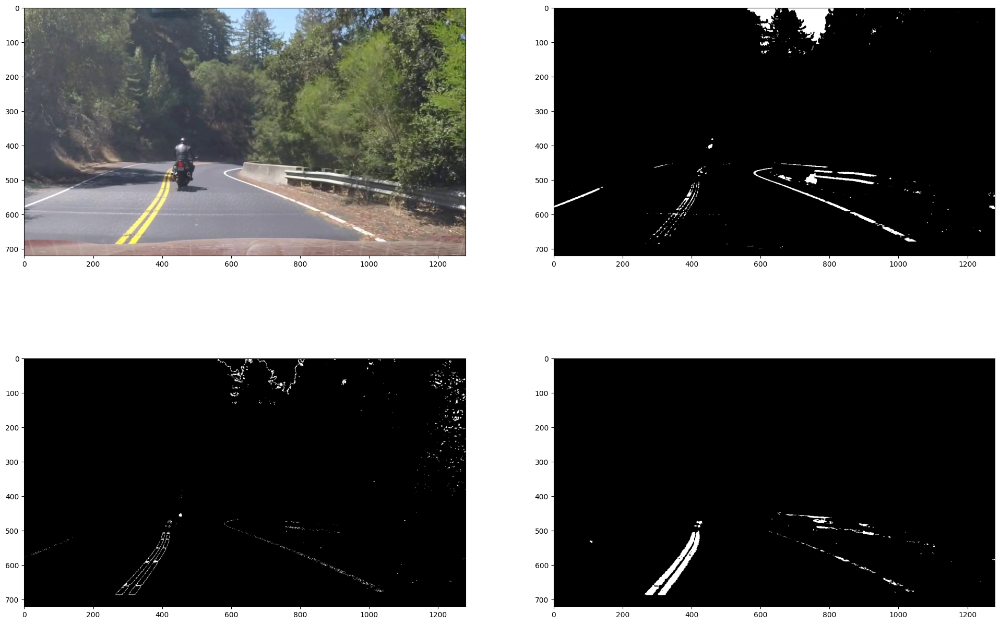

In [67]:
test(images2[2])

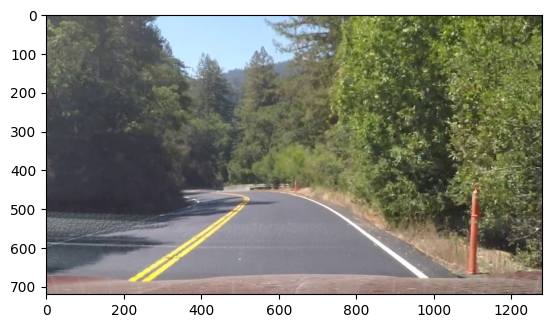

In [68]:
img = images2[1]
plt.imshow(img)

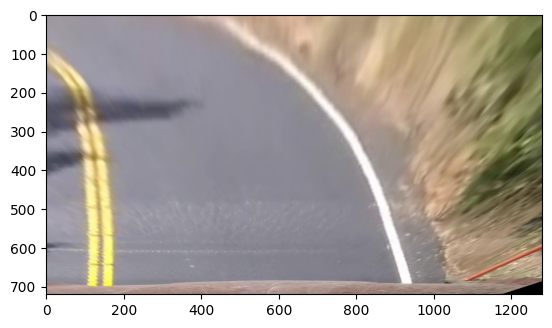

In [69]:
img1 = birdeye.forward(img)
plt.imshow(img1)

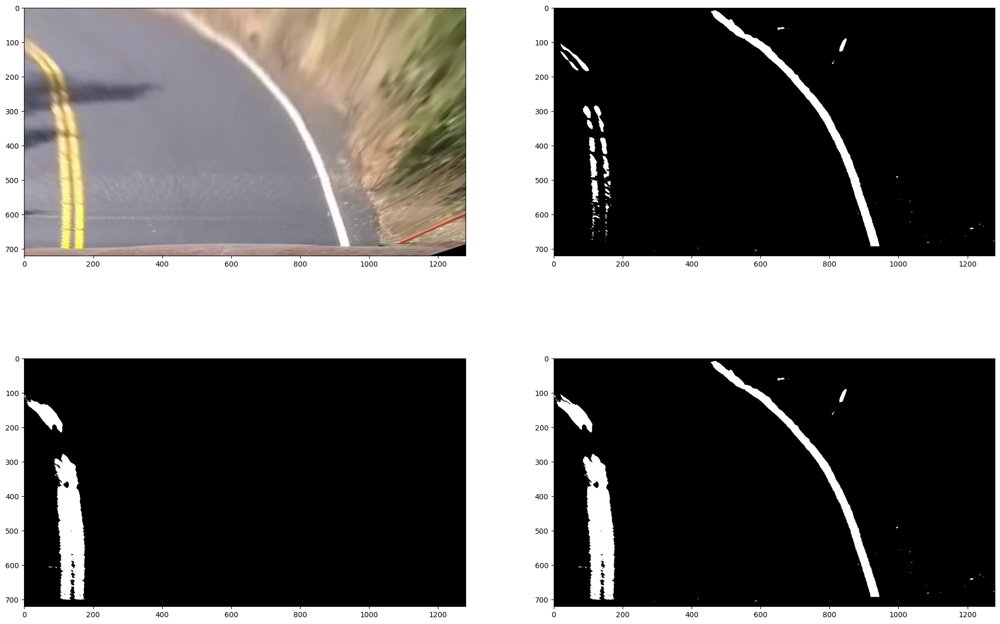

In [70]:
hls = cv2.cvtColor(img1, cv2.COLOR_RGB2HLS)
hsv = cv2.cvtColor(img1, cv2.COLOR_RGB2HSV)
h_channel = hls[:,:,0]
l_channel = hls[:,:,1]
s_channel = hls[:,:,2]
v_channel = hsv[:,:,2]

f = plt.figure(figsize=(24, 16))
ax1 = f.add_subplot(2, 2, 1)
ax1.imshow(img1)
ax2 = f.add_subplot(2, 2, 2)
right_lane = threshold_rel(l_channel, 0.8, 1.0)
# right_lane[:,:750] = 0
ax2.imshow(right_lane, vmin=0, vmax=255, cmap='gray')

ax3 = f.add_subplot(2, 2, 3)
left_lane = threshold_abs(h_channel, 20, 30)
left_lane &= threshold_rel(v_channel, 0.7, 1.0)
left_lane[:,550:] = 0
ax3.imshow(left_lane, vmin=0, vmax=255, cmap='gray')

img2 = left_lane | right_lane
ax4 = f.add_subplot(2, 2, 4)
ax4.imshow(img2, vmin=0, vmax=255, cmap='gray')

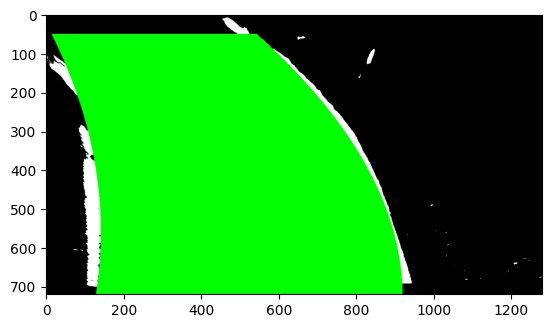

In [71]:
lanelines = LaneLines()
img3 = lanelines.forward(img2)
plt.imshow(img3)

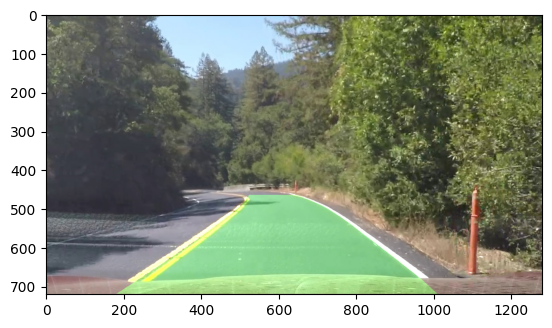

In [72]:
img4 = birdeye.backward(img3)
out_img = cv2.addWeighted(img, 1, img4, 0.3, 0)
plt.imshow(out_img)

In [5]:
birdeye = PerspectiveTransformation()
lanelines = LaneLines()
def process_image(img):
    # step 1
    img1 = birdeye.forward(img)
#     img1 = np.copy(img)
    
    # step 2
    hls = cv2.cvtColor(img1, cv2.COLOR_RGB2HLS)
    hsv = cv2.cvtColor(img1, cv2.COLOR_RGB2HSV)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    v_channel = hsv[:,:,2]

    right_lane = threshold_rel(l_channel, 0.8, 1.0)
    right_lane[:,:750] = 0

    left_lane = threshold_abs(h_channel, 20, 30)
    left_lane &= threshold_rel(v_channel, 0.7, 1.0)
    left_lane[:,550:] = 0

    img2 = left_lane | right_lane
 
    # step 3
    img3 = lanelines.forward(img2)
    
    # step 4
    img4 = birdeye.backward(img3)
    out_img = cv2.addWeighted(img, 1, img4, 1, 0)
    
    return out_img

In [74]:
tmp = process_image(images[4])
plt.imshow(tmp)

TypeError: 'NoneType' object is not subscriptable

In [36]:
clip = VideoFileClip("challenge_video.mp4")

In [37]:
Video("challenge_video.mp4")

In [38]:
out_clip = clip.fl_image(process_image)
out_clip.write_videofile("output_videos/tmp.mp4", audio=False)

Moviepy - Building video output_videos/tmp.mp4.
Moviepy - Writing video output_videos/tmp.mp4



Moviepy - Done !
Moviepy - video ready output_videos/tmp.mp4


In [39]:
Video("output_videos/tmp.mp4")

In [6]:
from main import FindLaneLines
import numpy as np
import matplotlib.image as mpimg
import cv2
from IPython.display import HTML, Video
from moviepy.editor import VideoFileClip
from CameraCalibration import CameraCalibration
from Thresholding import *
from PerspectiveTransformation import *
from LaneLines import *

In [7]:
calibration = CameraCalibration('camera_cal', 9, 6)
thresholding = Thresholding()
transform = PerspectiveTransformation()
lanelines = LaneLines()

In [10]:
img = images2[1]
out_img = np.copy(img)
img = calibration.undistort(img)
img = transform.forward(img)
img = thresholding.forward(img)
img = lanelines.forward(img)
img = transform.backward(img)
out_img = cv2.addWeighted(out_img, 1, img, 0.6, 0)
# out_img = lanelines.plot(out_img)

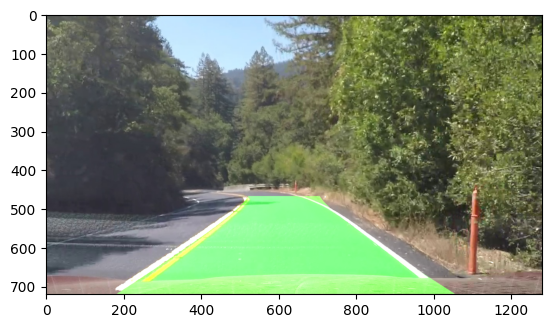

In [11]:

plt.imshow(out_img)

In [29]:

findLaneLines.process_video("/Users/namle/BachKhoa/HK232/DOANAI/test_video.mp4", "/Users/namle/BachKhoa/HK232/DOANAI/Advanced-Lane-Lines/output_video.mp4")

TypeError: 'NoneType' object is not subscriptable

In [8]:
findLaneLines = FindLaneLines()
clip = VideoFileClip("/Users/namle/BachKhoa/HK232/DOANAI/Advanced-Lane-Lines/project_video.mp4")
out_clip = clip.fl_image(findLaneLines.forward)
out_clip.ipython_display(fps=10)


Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


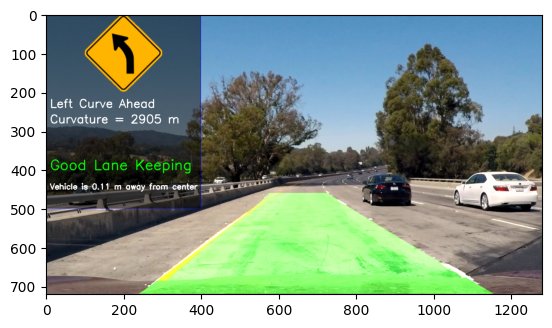

In [20]:
# img = mpimg.imread("/Users/namle/BachKhoa/HK232/DOANAI/Advanced-Lane-Lines/test_images/test1.jpg")
img = cv2.imread("/Users/namle/BachKhoa/HK232/DOANAI/Advanced-Lane-Lines/test_images/test1.jpg")
b, g, r = cv2.split(img)
img = cv2.merge([r, g, b])
out_img = np.copy(img)
img = calibration.undistort(img)
img = transform.forward(img)
img = thresholding.forward(img)
img = lanelines.forward(img)
img = transform.backward(img)
out_img = cv2.addWeighted(out_img, 1, img, 0.6, 0)
out_img = lanelines.plot(out_img)
plt.imshow(out_img)

In [11]:
IMG_SIZE  = [640, 360]
video = cv2.VideoCapture("/Users/namle/BachKhoa/HK232/DOANAI/Advanced-Lane-Lines/project_video.mp4")
video.set(cv2.CAP_PROP_FPS, 10)
while (video.isOpened()):
    try:
        flag, img = video.read()
        if not flag: break
        b, g, r = cv2.split(img)
        img = cv2.merge([r, g, b])
        out_img = np.copy(img)
        img = calibration.undistort(img)
        img = transform.forward(img)
        img = thresholding.forward(img)
        img = lanelines.forward(img)
        img = transform.backward(img)
        out_img = cv2.addWeighted(out_img, 1, img, 0.6, 0)
        out_img = lanelines.plot(out_img)

        cv2.imshow("test",out_img)
        if cv2.waitKey(1) == ord('q'):break
    except Exception as e:
        print(e)
   
video.release()
cv2.destroyAllWindows()

In [30]:
findLaneLines = FindLaneLines()
clip = VideoFileClip("/Users/namle/BachKhoa/HK232/DOANAI/Advanced-Lane-Lines/project_video.mp4")
out_clip = clip.fl_image(findLaneLines.forward)

In [31]:
video(out_clip)

TypeError: 'cv2.VideoCapture' object is not callable

In [6]:
from main import FindLaneLines
finland = FindLaneLines()
out_img = finland.process_image("/Users/namle/BachKhoa/HK232/DOANAI/Advanced-Lane-Lines/test_images/challenge_video_frame_1.jpg","/Users/namle/BachKhoa/HK232/DOANAI/Advanced-Lane-Lines/output_videos")

ValueError: unknown file extension: 

In [8]:
from CameraCalibration import CameraCalibration
from Thresholding import *
from PerspectiveTransformation import *
from LaneLines import *
calibration = CameraCalibration('camera_cal', 9, 6)
thresholding = Thresholding()
transform = PerspectiveTransformation()
lanelines = LaneLines()

img = mpimg.imread("/Users/namle/BachKhoa/HK232/DOANAI/Advanced-Lane-Lines/test_images/challenge_video_frame_10.jpg")
b, g, r = cv2.split(img)
img = cv2.merge([r, g, b])
out_img = np.copy(img)
img = calibration.undistort(img)
img = transform.forward(img)
bird_eye_img = np.copy(img)
img = thresholding.forward(img)
img = lanelines.forward(img)
img = transform.backward(img)
out_img = cv2.addWeighted(out_img, 1, img, 0.6, 0)
out_img = lanelines.plot(out_img)

TypeError: 'NoneType' object is not subscriptable